<div style="background-color:#a7e8d9; padding: 20px; border-radius: 10px; box-shadow: 0 2px 4px 0 rgba(0, 0, 0, 0.1);">
    <h1 style="font-size:24px; font-family:calibri; color:#141140;"><b>🚀 YOLO: The Real-Time Object Detection Revolution</b></h1>
    <p style="font-size:20px; font-family:calibri; line-height: 1.5em; text-indent: 20px;">
        <strong>YOLO</strong>, short for "<strong>You Only Look Once</strong>", revolutionizes object detection in computer vision by offering a fast and streamlined approach. It uniquely simplifies the detection process, treating it as a single-step task that combines object localization and classification. This innovative method allows YOLO to process images and videos in real-time with high accuracy. The latest version, <strong>YOLOv8</strong>, further enhances this technology, adeptly tackling challenges in object detection and image segmentation. YOLO's real-time capabilities make it a standout choice for applications needing rapid and precise object identification.
    </p>
</div>

<div style="background-color:#a7e8d9; padding: 20px; border-radius: 10px; box-shadow: 0 2px 4px 0 rgba(0, 0, 0, 0.1);"> <h1 style="font-size:24px; font-family:calibri; color:#141140;"><b>🚀 YOLO: Fast, Smart, and Game-Changing in Object Detection</b></h1> <p style="font-size:20px; font-family:calibri; line-height: 1.5em; text-indent: 20px;"> <strong>YOLO</strong> (short for "<strong>You Only Look Once</strong>") has completely changed the way we do object detection in computer vision. Instead of using slow, multi-step processes, YOLO **looks at an image just once** and instantly identifies objects within it. This makes it incredibly **fast and efficient**, perfect for real-time applications like self-driving cars, surveillance, and robotics. <br><br> The latest version, <strong>YOLOv8</strong>, takes things even further with improved accuracy and smarter detection capabilities. Whether it's spotting multiple objects in an image or analyzing video streams on the fly, YOLO is a **powerful tool that blends speed with precision**. No wonder it's a favorite in AI-powered vision tasks! </p> </div>

<div style="background-color:#eae8fa; padding: 20px; border-radius: 10px; box-shadow: 0 2px 4px 0 rgba(0, 0, 0, 0.1);"> <h1 style="font-size:24px; font-family:calibri; color:#141140;"><b>🚦 Understanding Traffic Density with YOLO</b></h1> <p style="font-size:20px; font-family:calibri; line-height: 1.5em; text-indent: 20px;"> This project uses <strong>YOLO’s real-time object detection</strong> to estimate **traffic density**, a crucial factor in urban mobility and traffic management. The idea is simple but powerful—by counting vehicles in each frame, we can analyze traffic flow, identify **congested areas**, and detect peak traffic times. These insights can help improve **city planning, traffic control, and overall transportation efficiency**. <br><br> Our goal is to develop a **smart traffic monitoring system** that provides valuable real-time data for better decision-making in **urban development and transportation management**. </p> </div>

<div style="background-color:#eae8fa; padding: 20px; border-radius: 10px; box-shadow: 0 2px 4px 0 rgba(0, 0, 0, 0.1);"> <h1 style="font-size:24px; font-family:calibri; color:#141140;"><b>🎯 Project Goals</b></h1> <ul style="font-size:20px; font-family:calibri; line-height: 1.5em;"> <li><strong>Getting Started with YOLOv8:</strong> Choosing the right pre-trained YOLOv8 model and testing its initial performance on the **COCO dataset** for vehicle detection.</li> <li><strong>Building a Custom Vehicle Dataset:</strong> Collecting and annotating a specialized dataset to help the model recognize a **wide range of vehicles** more accurately.</li> <li><strong>Fine-Tuning for Better Accuracy:</strong> Using **transfer learning** to improve the model’s ability to detect vehicles, especially from **aerial views**, making it more precise and reliable.</li> <li><strong>Evaluating Model Performance:</strong> Analyzing learning curves, **confusion matrices**, and other performance metrics to assess **accuracy, precision, and recall**.</li> <li><strong>Real-World Testing:</strong> Running the model on **validation images, unseen test data, and videos** to see how well it generalizes to new scenarios.</li> <li><strong>Traffic Density Estimation:</strong> Developing an algorithm to **count vehicles** and measure traffic congestion **in real-time** using video data.</li> </ul> </div>


# Import Modules

In [1]:
import warnings
warnings.filterwarnings('ignore')
!pip install --no-cache-dir ultralytics
# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [2]:
# !pip install --no-cache-dir roboflow

#from roboflow import Roboflow
#rf = Roboflow(api_key="qZpnQsiPL8rFEp0Q04CG")
#project = rf.workspace("vehicle-matkm").project("detection-b3wly")
#version = project.version(5)
#dataset = version.download("yolov8")


In [3]:
# Configure the visual appearance of seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

# Load Pretrained Model

In [4]:
model = YOLO('yolov8n.pt')

# Path to image file

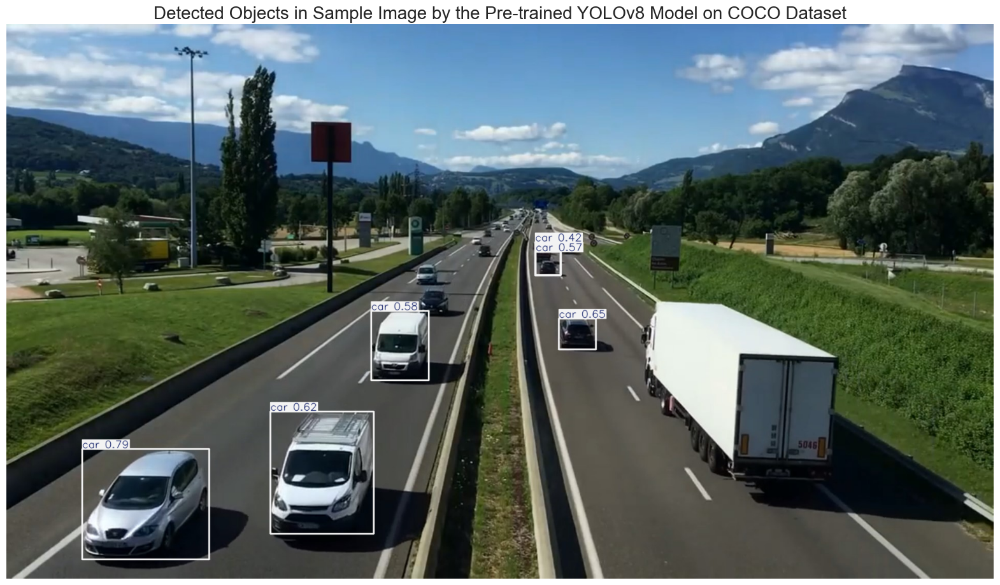

In [5]:
image_path = 'Detection-5/sample_image.jpg'

results = model.predict(source=image_path, 
                        imgsz=640,
                        verbose=False,
                        conf=0.4)  

sample_image = results[0].plot(line_width=2)

sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [6]:
dataset_path = 'Detection-5'

yaml_file_path = 'Detection-5/data.yaml'

with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader = yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: train/images
val: valid/images



In [7]:

trian_image_path = os.path.join(dataset_path, 'train', 'images')
validation_image_path = os.path.join(dataset_path, 'valid', 'images')
print(trian_image_path)
print(validation_image_path)

num_trian_images = 0
num_valid_images = 0


train_image_size = set()
valid_image_size = set()

# Check train images sizes and count
for filename in os.listdir(trian_image_path):
    if filename.endswith('.jpg'):
        num_trian_images += 1
        image_path = os.path.join(trian_image_path, filename)
        with Image.open(image_path) as img:
            train_image_size.add(img.size)
            
# Check validation images sizes and count
for filename in os.listdir(validation_image_path):
    if filename.endswith('.jpg'):
        num_valid_images +=1
        image_path = os.path.join(validation_image_path, filename)
        with Image.open(image_path) as img:
            valid_image_size.add(img.size)
            
            
print(f"Number of training images:, {num_trian_images}")
print(f"Number of validation images: {num_valid_images}")

if len(train_image_size) == 1:
    print(f"All training images have the same size: {train_image_size.pop()}")
else:
    print("Training images have verying sizes.")
    
if len(valid_image_size) == 1:
    print(f"All validation images have the same size: {valid_image_size.pop()}")
    
else:
    print("Validation images have verying sizes")
    

Detection-5/train/images
Detection-5/valid/images
Number of training images:, 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


# Data Visualization

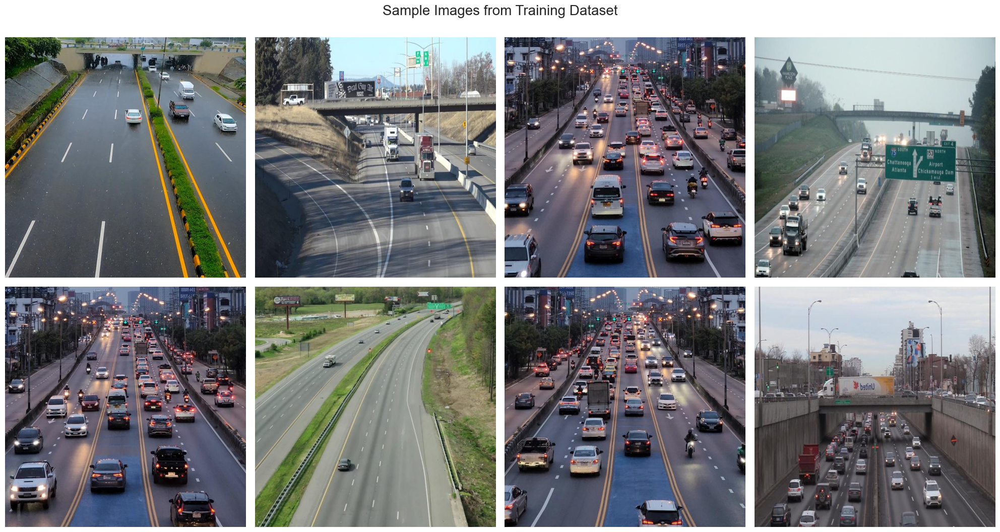

In [8]:
image_files = [file for file in os.listdir(trian_image_path) if file.endswith('.jpg')]

num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

fig,axes = plt.subplots(2,4,figsize=(20,11))

for ax, img_file in zip(axes.ravel(), selected_images):
    img_path =os.path.join(trian_image_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')
    
plt.suptitle('Sample Images from Training Dataset',fontsize=20)
plt.tight_layout()
plt.show()

# Fine tunning YOLOv8 model

In [10]:
print(yaml_file_path)
results = model.train(
    data =yaml_file_path,
    epochs = 50,
    imgsz=640,
    device="CPU",
    patience=50,
    batch = 32,
    optimizer='auto',
    lr0 = 0.0001,
    lrf = 0.1,
    dropout=0.1, 
    save_period=10  
)

Detection-5/data.yaml
Ultralytics YOLOv8.2.60 🚀 Python-3.12.3 torch-2.3.1 CPU (Apple M3 Pro)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=Detection-5/data.yaml, epochs=50, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=10, cache=False, device=CPU, workers=8, project=None, name=train23, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show

train: Scanning /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection
val: Scanning /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection-5

Plotting labels to runs/detect/train23/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train23
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G       2.32      2.796      1.779        363        640: 100%|██████████| 17/17 [04:08<00:00, 14.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937    0.00333     0.0961    0.00223   0.000716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       2/50         0G        1.5      1.292      1.189        409        640: 100%|██████████| 17/17 [03:57<00:00, 13.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937    0.00711      0.205     0.0239     0.0104

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       3/50         0G        1.3     0.9887      1.071        362        640: 100%|██████████| 17/17 [04:00<00:00, 14.1
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.747      0.432      0.504      0.287

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       4/50         0G      1.209     0.8836      1.031        525        640: 100%|██████████| 17/17 [04:05<00:00, 14.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937       0.84      0.794      0.869      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       5/50         0G      1.183     0.8326      1.019        401        640: 100%|██████████| 17/17 [04:08<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.833      0.835      0.903      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       6/50         0G      1.161     0.8034      1.012        432        640: 100%|██████████| 17/17 [04:08<00:00, 14.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.892      0.838      0.936      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       7/50         0G      1.142     0.7872     0.9984        357        640: 100%|██████████| 17/17 [03:51<00:00, 13.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.845      0.907      0.934      0.637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       8/50         0G      1.109     0.7681      0.996        389        640: 100%|██████████| 17/17 [03:52<00:00, 13.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.792      0.896      0.903      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       9/50         0G      1.115     0.7282     0.9972        274        640: 100%|██████████| 17/17 [03:55<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.864      0.922      0.943      0.657

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      10/50         0G      1.107     0.7085     0.9933        373        640: 100%|██████████| 17/17 [03:53<00:00, 13.7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.839      0.887      0.935      0.644

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      11/50         0G      1.087     0.6991     0.9863        325        640: 100%|██████████| 17/17 [03:54<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.817      0.925      0.914      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      12/50         0G      1.087     0.6586     0.9815        360        640: 100%|██████████| 17/17 [03:58<00:00, 14.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937       0.87      0.914      0.952      0.668

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      13/50         0G      1.072     0.6535     0.9739        348        640: 100%|██████████| 17/17 [03:55<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.881      0.927      0.962        0.7

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      14/50         0G      1.075      0.671     0.9756        392        640: 100%|██████████| 17/17 [04:09<00:00, 14.7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.897      0.905      0.962      0.687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      15/50         0G      1.052     0.6408     0.9707        321        640: 100%|██████████| 17/17 [03:58<00:00, 14.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.907      0.898      0.967      0.694

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      16/50         0G      1.057     0.6281     0.9608        370        640: 100%|██████████| 17/17 [04:14<00:00, 14.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.886      0.933      0.962      0.687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      17/50         0G      1.058     0.6162     0.9663        326        640: 100%|██████████| 17/17 [04:09<00:00, 14.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.905      0.926      0.969      0.701

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      18/50         0G      1.019     0.5999     0.9583        282        640: 100%|██████████| 17/17 [04:01<00:00, 14.2
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.894      0.915      0.963      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      19/50         0G      1.026     0.5976     0.9609        389        640: 100%|██████████| 17/17 [04:08<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.891      0.917      0.967      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      20/50         0G      1.024     0.5879     0.9608        324        640: 100%|██████████| 17/17 [04:09<00:00, 14.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.916      0.885      0.963      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      21/50         0G      1.014     0.5815     0.9551        363        640: 100%|██████████| 17/17 [04:08<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.903      0.898      0.964       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      22/50         0G      1.014     0.5678     0.9533        407        640: 100%|██████████| 17/17 [04:14<00:00, 14.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.898      0.923      0.964      0.698

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      23/50         0G      1.002     0.5713     0.9549        193        640: 100%|██████████| 17/17 [04:12<00:00, 14.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937       0.86      0.928      0.958      0.702

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      24/50         0G      1.009     0.5581     0.9482        307        640: 100%|██████████| 17/17 [04:00<00:00, 14.1
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.895       0.93      0.963      0.691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      25/50         0G     0.9874     0.5628     0.9454        398        640: 100%|██████████| 17/17 [04:11<00:00, 14.7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.901      0.908      0.965      0.704

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      26/50         0G          1     0.5686     0.9461        376        640: 100%|██████████| 17/17 [04:09<00:00, 14.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.928      0.912      0.975      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      27/50         0G      0.973     0.5428     0.9396        352        640: 100%|██████████| 17/17 [04:18<00:00, 15.2
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.904      0.927      0.972      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      28/50         0G     0.9719     0.5428     0.9441        405        640: 100%|██████████| 17/17 [04:18<00:00, 15.1
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.908      0.922      0.965      0.718

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      29/50         0G     0.9909     0.5525     0.9445        275        640: 100%|██████████| 17/17 [04:11<00:00, 14.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.917      0.911      0.973      0.707

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      30/50         0G     0.9652     0.5321     0.9439        437        640: 100%|██████████| 17/17 [03:51<00:00, 13.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.916      0.928      0.971      0.711

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      31/50         0G     0.9685     0.5382     0.9407        302        640: 100%|██████████| 17/17 [03:53<00:00, 13.7
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.916      0.914      0.973       0.72

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      32/50         0G     0.9559     0.5298      0.938        298        640: 100%|██████████| 17/17 [03:57<00:00, 13.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.912      0.931      0.975      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      33/50         0G     0.9661     0.5331     0.9388        274        640: 100%|██████████| 17/17 [03:58<00:00, 14.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937       0.92      0.916      0.972      0.717

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      34/50         0G     0.9521     0.5369     0.9321        321        640: 100%|██████████| 17/17 [03:56<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.908       0.93      0.974      0.718

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      35/50         0G     0.9538     0.5187      0.932        344        640: 100%|██████████| 17/17 [03:58<00:00, 14.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937       0.89      0.926      0.963      0.696

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      36/50         0G     0.9661     0.5375     0.9384        400        640: 100%|██████████| 17/17 [03:57<00:00, 13.9
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.911      0.925      0.976      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      37/50         0G     0.9495     0.5146     0.9346        341        640: 100%|██████████| 17/17 [04:05<00:00, 14.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.892      0.949      0.971      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      38/50         0G     0.9317     0.5099     0.9321        366        640: 100%|██████████| 17/17 [04:03<00:00, 14.3
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.902      0.942      0.973      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      39/50         0G     0.9393      0.509     0.9349        411        640: 100%|██████████| 17/17 [04:06<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.911      0.927      0.976      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      40/50         0G     0.9211      0.496     0.9206        354        640: 100%|██████████| 17/17 [03:55<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.914      0.937      0.975      0.736
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      41/50         0G     0.9178     0.4879     0.9336        244        640: 100%|██████████| 17/17 [03:51<00:00, 13.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.908      0.925      0.969      0.731

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      42/50         0G     0.9005     0.4705     0.9224        255        640: 100%|██████████| 17/17 [03:51<00:00, 13.6
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.924       0.92       0.97      0.725

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      43/50         0G     0.9084     0.4745     0.9283        239        640: 100%|██████████| 17/17 [03:58<00:00, 14.0
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.909      0.937      0.974      0.723

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      44/50         0G      0.892     0.4708     0.9196        243        640: 100%|██████████| 17/17 [03:55<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.916      0.922      0.975      0.715

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      45/50         0G     0.9068     0.4634     0.9235        279        640: 100%|██████████| 17/17 [03:55<00:00, 13.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.914      0.927      0.972      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      46/50         0G     0.8928     0.4624     0.9185        312        640: 100%|██████████| 17/17 [04:11<00:00, 14.8
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.896      0.939      0.973      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      47/50         0G     0.8897     0.4667     0.9181        246        640: 100%|██████████| 17/17 [04:07<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.904      0.942      0.975      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      48/50         0G     0.8794     0.4587     0.9178        194        640: 100%|██████████| 17/17 [04:07<00:00, 14.5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.901      0.952      0.973      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      49/50         0G     0.8784     0.4478     0.9174        256        640: 100%|██████████| 17/17 [04:01<00:00, 14.2
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00

                   all         90        937      0.909      0.947      0.976       0.74

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      50/50         0G     0.8757     0.4464     0.9173        243        640: 100%|██████████| 17/17 [04:04<00:00, 14.4
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00

                   all         90        937      0.907      0.948      0.975      0.737

50 epochs completed in 3.677 hours.
Optimizer stripped from runs/detect/train23/weights/last.pt, 6.2MB


Optimizer stripped from runs/detect/train23/weights/best.pt, 6.2MB

Validating runs/detect/train23/weights/best.pt...
Ultralytics YOLOv8.2.60 🚀 Python-3.12.3 torch-2.3.1 CPU (Apple M3 Pro)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00


                   all         90        937       0.91      0.946      0.976       0.74
Speed: 1.2ms preprocess, 224.6ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/train23


# Model Performance Evaluation

In [11]:
post_training_files_path ='runs/detect/train23'

!ls {post_training_files_path}

F1_curve.png                    train_batch0.jpg
PR_curve.png                    train_batch1.jpg
P_curve.png                     train_batch2.jpg
R_curve.png                     train_batch680.jpg
args.yaml                       train_batch681.jpg
confusion_matrix.png            train_batch682.jpg
confusion_matrix_normalized.png val_batch0_labels.jpg
labels.jpg                      val_batch0_pred.jpg
labels_correlogram.jpg          val_batch1_labels.jpg
results.csv                     val_batch1_pred.jpg
results.png                     weights


# Learning curve Analysis

In [12]:
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

best_model = YOLO(best_model_path)

metrics = best_model.val(split='val')

Ultralytics YOLOv8.2.60 🚀 Python-3.12.3 torch-2.3.1 CPU (Apple M3 Pro)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection-5
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:18<00


                   all         90        937       0.91      0.946      0.976       0.74
Speed: 1.2ms preprocess, 197.0ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/val


In [13]:
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

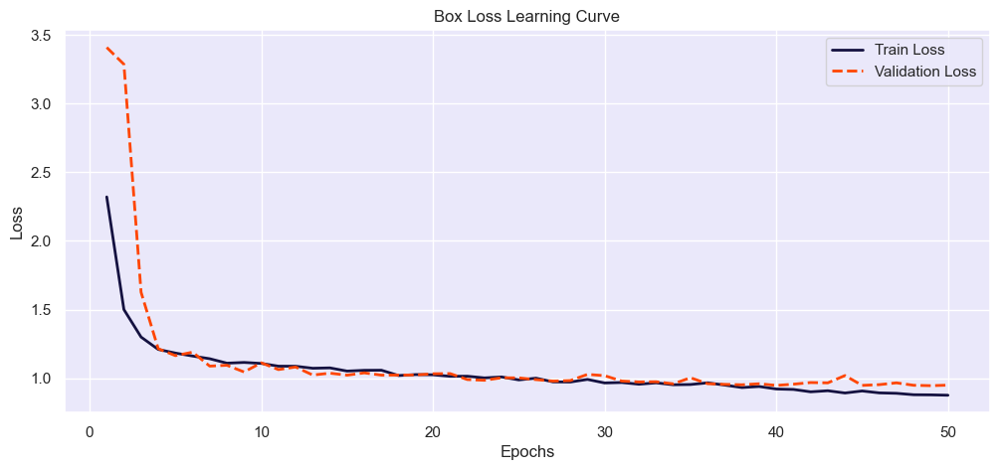

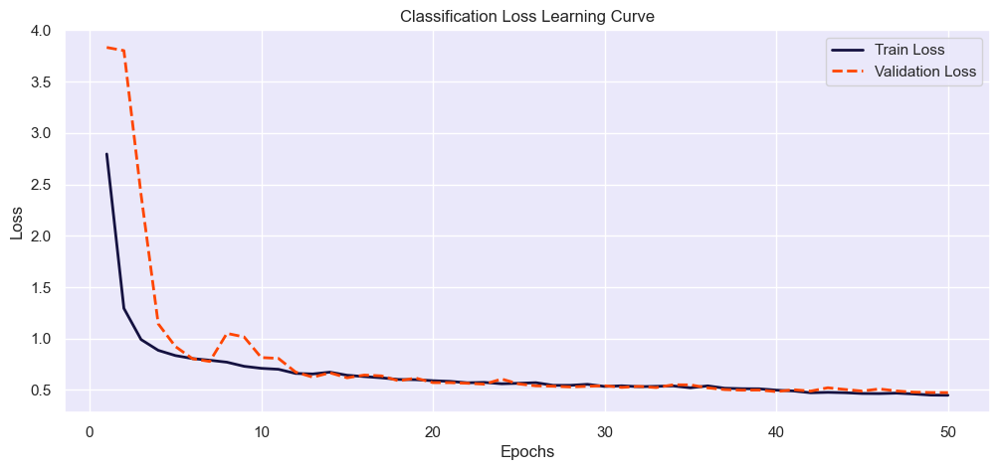

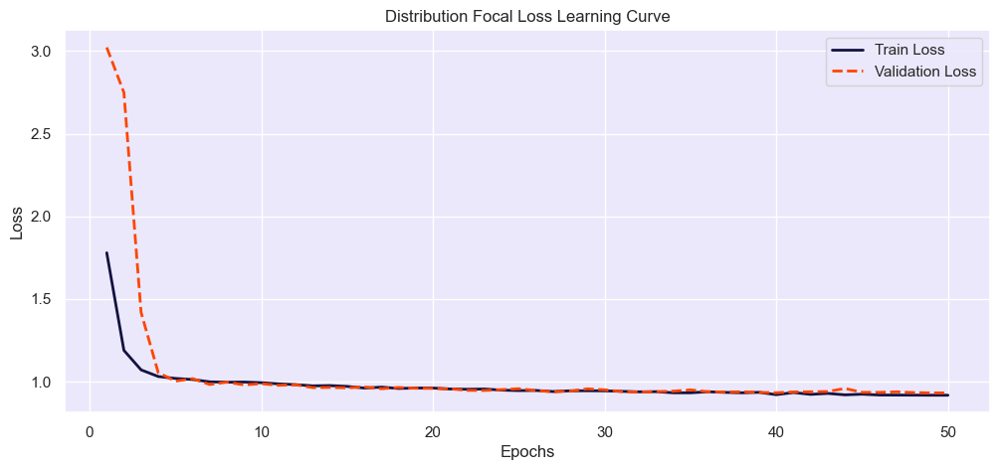

In [14]:
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

df = pd.read_csv(results_csv_path)

df.columns = df.columns.str.strip()

plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

# Model Inferance and Generalization Assessment


image 1/1 /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection-5/valid/images/14_mp4-24_jpg.rf.57d5fe50d543f58e3b1f761ee53e1aa8.jpg: 640x640 6 Vehicles, 75.8ms
Speed: 1.5ms preprocess, 75.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection-5/valid/images/14_mp4-10_jpg.rf.edf4723435ff483f7d55c474a60be14d.jpg: 640x640 7 Vehicles, 74.2ms
Speed: 1.4ms preprocess, 74.2ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/Detection-5/valid/images/5_mp4-29_jpg.rf.de506ae3402dafeffb1e6427af894871.jpg: 640x640 18 Vehicles, 71.6ms
Speed: 1.7ms preprocess, 71.6ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semeste

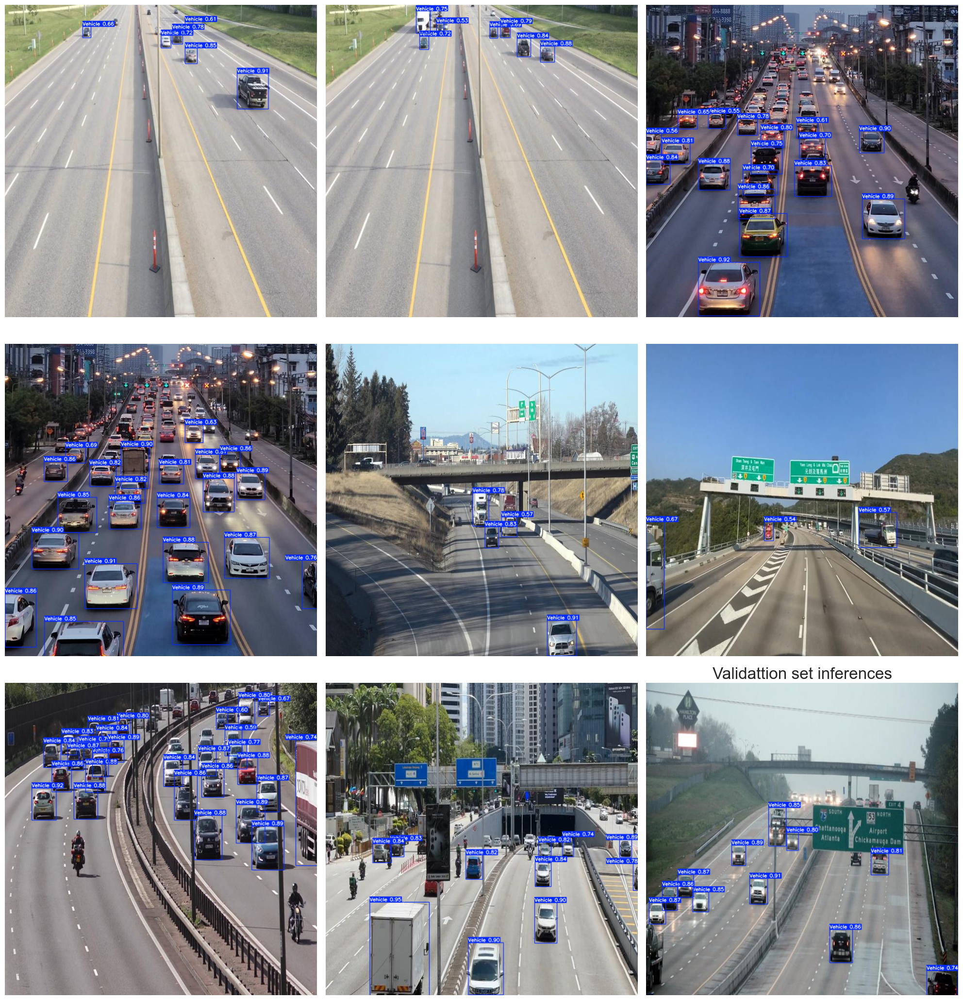

In [15]:
valid_image_path = os.path.join(dataset_path, 'valid','images')

# list all jpg images in the directory
image_files = [file for file in os.listdir(valid_image_path) if file.endswith('.jpg')]

# select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

fig, axes = plt.subplots(3,3,figsize=(20,21))
plt.title('Validattion set inferences', fontsize=24)


for i, ax, in enumerate(axes.flatten()):
    image_path = os.path.join(valid_image_path, selected_images[i])
    results = best_model.predict(source = image_path, imgsz = 640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb =cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')
    
plt.tight_layout()
plt.show()

# Inference on an unseen test image


image 1/1 /Users/mohsen/Desktop/mohsen/linux/Polimi/Semesters/Semester 3/Computer Vision/Project/Scripts/sample_image.jpg: 384x640 6 Vehicles, 63.6ms
Speed: 3.5ms preprocess, 63.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)


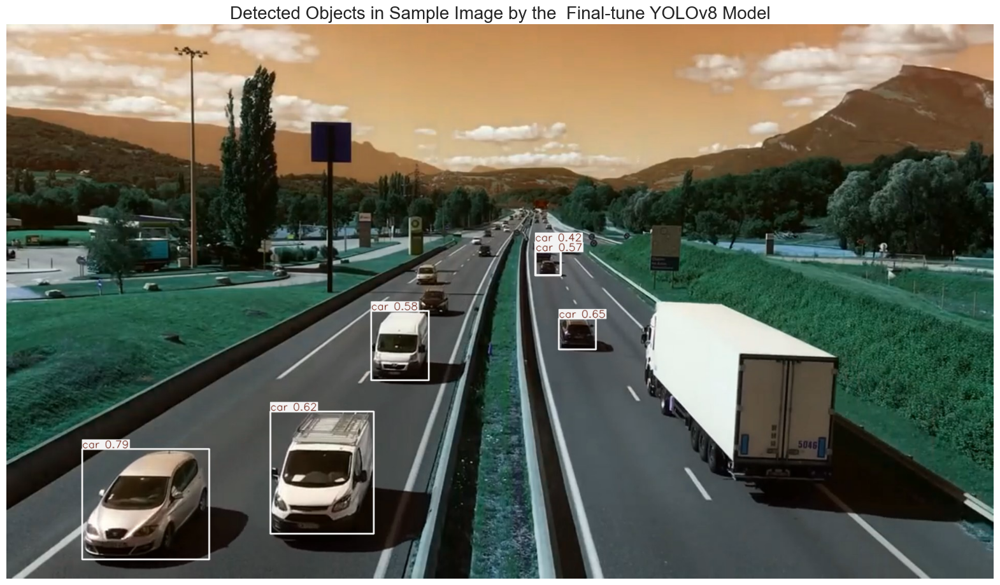

In [16]:
sample_image_path = 'sample_image.jpg'

results = best_model.predict(source=sample_image_path, imgsz=640,conf=0.7)

smaple_image = results[0].plot(line_width=2)

sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the  Final-tune YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

In [1]:
video_path = 'sample_video.mp4'

best_model.predict(source=video_path, save=True)

In [24]:
!ffmpeg -y -loglevel panic -i runs/detect/predict/sample_video.mp4 processed_sample_video.mp4

Video("processed_sample_video.mp4", embed=True, width=960)


# Real Time Traffic Intensity Esteminator

In [25]:
heavy_traffic_threshold = 4

vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

x1, x2 = 325, 635 
lane_threshold = 609

text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    
background_color = (0, 0, 255)  
        
cap = cv2.VideoCapture('sample_video.mp4')

fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

while cap.isOpened():
    
    ret, frame = cap.read()
    if ret:
        detection_frame = frame.copy()
    
        detection_frame[:x1, :] = 0  
        detection_frame[x2:, :] = 0  
        
        results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)
        
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()        
        
        cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)
        
        bounding_boxes = results[0].boxes

        # Initialize counters for vehicles in each lane
        vehicles_in_left_lane = 0
        vehicles_in_right_lane = 0

        for box in bounding_boxes.xyxy:
            if box[0] < lane_threshold:
                vehicles_in_left_lane += 1
            else:
                vehicles_in_right_lane += 1
                
        traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
        traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"


        cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25), 
                      (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

        cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25), 
                      (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25), 
                      (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

        cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25), 
                      (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        out.write(processed_frame)
        
    else:
        break

cap.release()
out.release()

# cv2.destroyAllWindows()


0: 384x640 (no detections), 62.7ms
Speed: 4.3ms preprocess, 62.7ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 44.0ms
Speed: 1.4ms preprocess, 44.0ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 42.8ms
Speed: 1.2ms preprocess, 42.8ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 39.8ms
Speed: 1.4ms preprocess, 39.8ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 39.2ms
Speed: 0.9ms preprocess, 39.2ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 38.9ms
Speed: 0.8ms preprocess, 38.9ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 42.2ms
Speed: 2.0ms preprocess, 42.2ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 39.9ms
Speed: 1.6ms preprocess, 39.9ms i

In [26]:
!ffmpeg -y -loglevel panic -i traffic_density_analysis.avi traffic_density_analysis.mp4

Video("traffic_density_analysis.mp4", embed=True, width=960)